In [184]:
import os
import pandas as pd
from pandas import DataFrame, Series
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.ticker import FixedLocator, MaxNLocator
from matplotlib import font_manager, rc
font_name = font_manager.FontProperties(fname='c:/windows/fonts/H2GTRM.TTF').get_name()
rc('font',family=font_name)
from IPython.display import Image
import folium
from folium.plugins import HeatMap
import warnings
warnings.filterwarnings('ignore')
import matplotlib
matplotlib.rcParams['axes.unicode_minus'] = False

https://www.kaggle.com/datasets/fivethirtyeight/uber-pickups-in-new-york-city    
kaggle의 Uber pickups in NYC 데이터 사용.   
전체 파일 중에서 uber의 2014년 데이터만 추출함.    

__4가지의 컬럼__    
* Data/Time : 픽업 일자 및 시간
* Lat : 픽업 장소의 위도
* Lon : 픽업 장소의 경도
* Base : 픽업 회사의 코드

In [2]:
file_list = os.listdir('c:/data/uber_pickup_nyc')

In [3]:
file_list

['other-American_B01362.csv',
 'other-Carmel_B00256.csv',
 'other-Dial7_B00887.csv',
 'other-Diplo_B01196.csv',
 'other-Federal_02216.csv',
 'other-FHV-services_jan-aug-2015.csv',
 'other-Firstclass_B01536.csv',
 'other-Highclass_B01717.csv',
 'other-Lyft_B02510.csv',
 'other-Prestige_B01338.csv',
 'other-Skyline_B00111.csv',
 'Uber-Jan-Feb-FOIL.csv',
 'uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-janjune-15.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [8]:
uber_idx = []
for i,j in enumerate(file_list):
    if '14.csv' in j:
        uber_idx.append(i)
uber_df = DataFrame()
for idx in uber_idx:
    df = pd.read_csv('c:/data/uber_pickup_nyc/'+file_list[idx],encoding='cp1252')
    uber_df = pd.concat([uber_df,df])

In [151]:
uber_df = uber_df.reset_index(drop=True)

In [9]:
uber_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4534327 entries, 0 to 1028135
Data columns (total 4 columns):
 #   Column     Dtype  
---  ------     -----  
 0   Date/Time  object 
 1   Lat        float64
 2   Lon        float64
 3   Base       object 
dtypes: float64(2), object(2)
memory usage: 173.0+ MB


__데이터 전처리__    
- 중복된 데이터 확인 후 제거
- 일자 및 시간을 datetime 양식으로 변경 후 각 시각, 요일, 월, 일자로 나누어줌.

In [10]:
uber_df.duplicated().sum()

82581

In [11]:
uber_df.drop_duplicates(inplace=True)

In [12]:
uber_df['Date/Time'] = pd.to_datetime(uber_df['Date/Time'], format='%m/%d/%Y %H:%M:%S')
uber_df['Hour'] = uber_df['Date/Time'].dt.hour
uber_df['DayofWeek'] = uber_df['Date/Time'].dt.day_name()
uber_df['Month'] = uber_df['Date/Time'].dt.month
uber_df['Day'] = uber_df['Date/Time'].dt.day

픽업 수가 많은 요일을 확인하기 위해 countplot을 사용.    
목요일이 가장 많고, 일요일이 가장 적음.

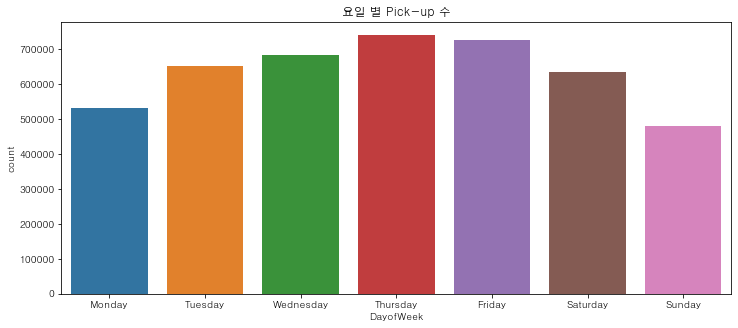

In [13]:
plt.figure(figsize = (12,5))
sns.countplot(data=uber_df,x='DayofWeek',order=['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']);
plt.title('요일 별 Pick-up 수');

시간대별로 확인해보면 토요일, 일요일에는 약속 후 늦게 귀가하는 사람이 많아서 0시에서 3시 사이에 이용자 수가 많음.    
금요일, 토요일 21시부터 24시까지는 이용자 수가 많지만, 일요일은 다음날이 평일이라 이용자 수가 적음.    
출근시간대인 6시부터 8시까지는 평일 이용량이 많고, 주말에는 없음.

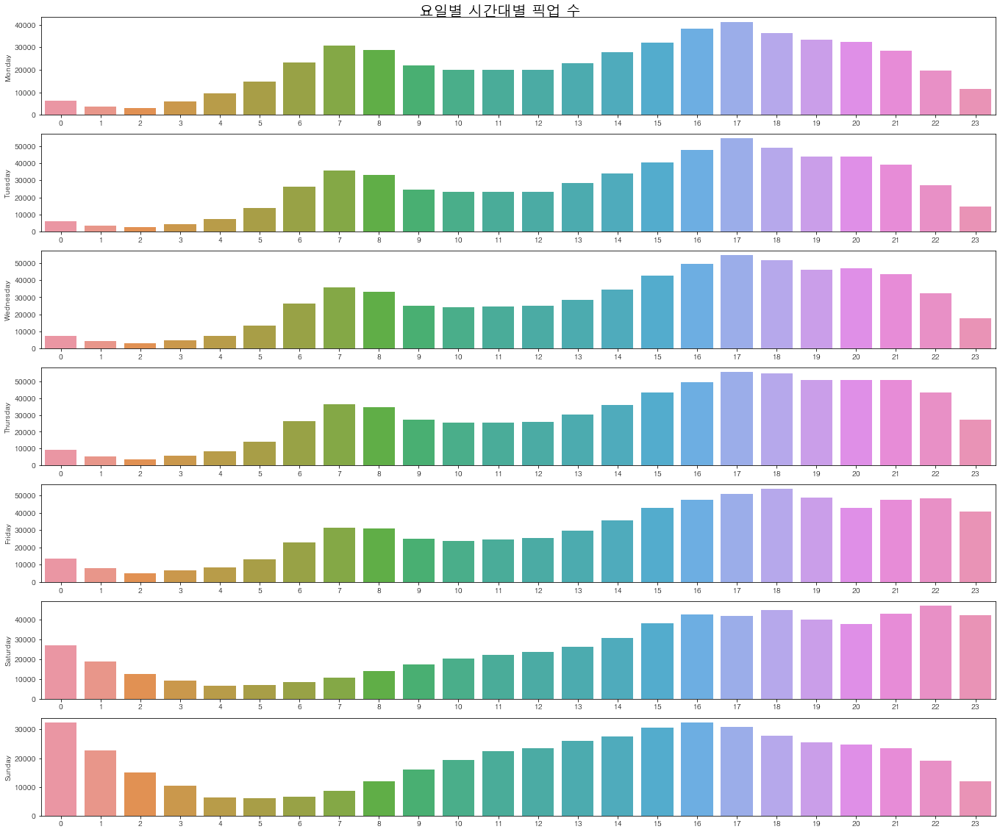

In [14]:
fig,axs = plt.subplots(7,1,figsize=(19,16))
axs = axs.flatten()
num = 0
for i in ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']:
    chart = sns.countplot(data=uber_df.loc[uber_df['DayofWeek']==i], x='Hour', ax=axs[num]);
    chart.set(ylabel=i,xlabel='');
    num += 1
fig.suptitle('요일별 시간대별 픽업 수', fontsize=20, fontweight='bold')
fig.tight_layout()

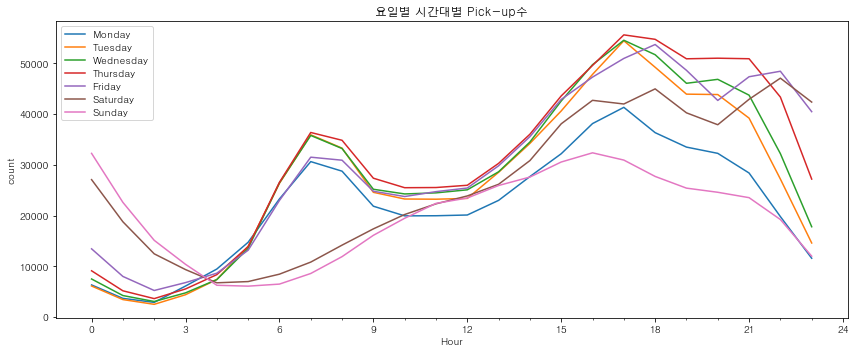

In [27]:
df = uber_df.groupby(['DayofWeek','Hour'])['Month'].count().reset_index(name='count')
df.DayofWeek = pd.Categorical(df.DayofWeek, categories=['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
df.sort_values('DayofWeek')

plt.figure(figsize=(12,5))
plt.title('요일별 시간대별 Pick-up수')
chart = sns.lineplot(data=df, x='Hour',y='count',
             hue='DayofWeek');
chart.xaxis.set_major_locator(MaxNLocator(steps=[3]))
chart.xaxis.set_minor_locator(FixedLocator(range(0,24)))
chart.legend(loc='best');
plt.tight_layout()

In [16]:
uber_df.head()

,Date/Time,Lat,Lon,Base,Hour,DayofWeek,Month,Day
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,0,Tuesday,4,1
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,0,Tuesday,4,1
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,0,Tuesday,4,1
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,0,Tuesday,4,1
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,0,Tuesday,4,1


월별 픽업수를 비교하기 위해 countplot 사용

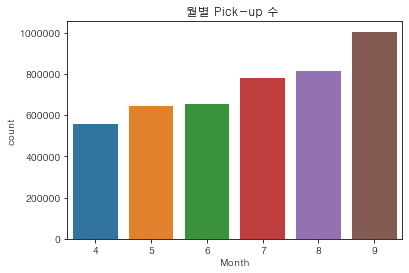

In [17]:
fig, axs = plt.subplots()
axs.ticklabel_format(style='plain')
plt.title('월별 Pick-up 수 ')
sns.countplot(data=uber_df,x='Month');

9월이 픽업 수가 가장 많고, 4월이 가장 적음. 두 달의 차이를 비교해볼 예정.

In [18]:
data_df = uber_df.loc[uber_df['Month'].isin([4,9]),['DayofWeek','Hour','Month']].groupby(['Month','Hour'])['DayofWeek'].count().reset_index(name='count')

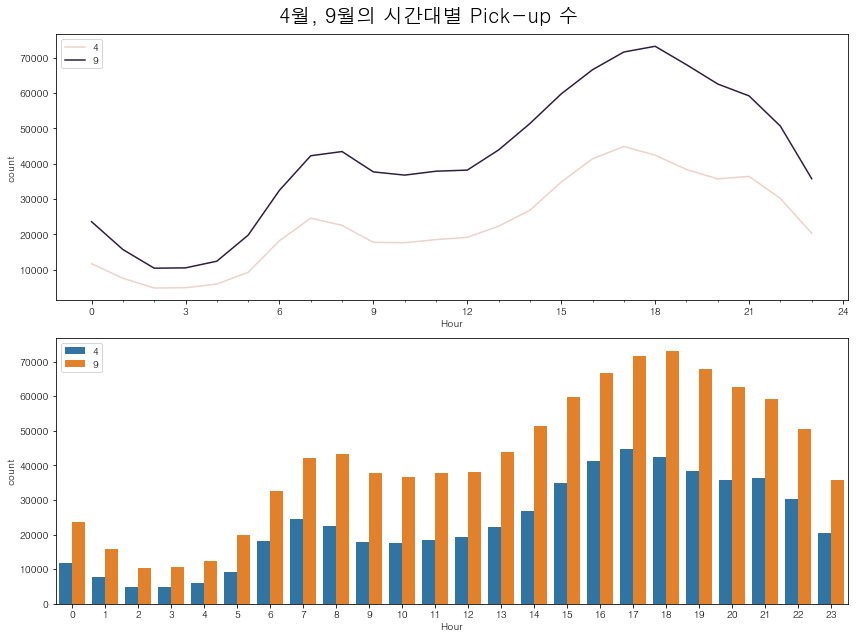

In [19]:
fig,ax = plt.subplots(2,1,figsize=(12,9))
plt.suptitle('4월, 9월의 시간대별 Pick-up 수',fontsize=20,fontweight='bold');
chart = sns.lineplot(data=data_df,x='Hour',y='count',hue='Month',ax=ax[0])
chart.xaxis.set_major_locator(MaxNLocator(steps=[3]))
chart.xaxis.set_minor_locator(FixedLocator(range(0,24)))
chart.legend(loc='upper left');
chart = sns.barplot(data=data_df,x='Hour',y='count',hue='Month',ax=ax[1]);
chart.legend(loc='upper left');
plt.tight_layout()

시간대 별로는 출퇴근 시간에 이용자 수가 많아지는 같은 그래프 양상을 보임.    
시간대 별로는 차이가 유의미 하지 않아, 일자별로 비교.

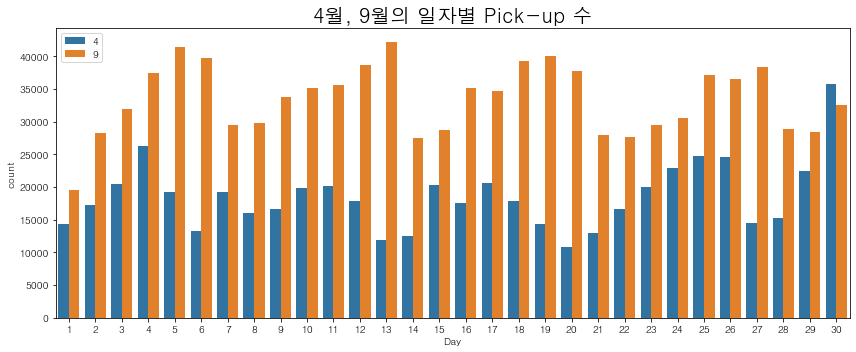

In [20]:
plt.figure(figsize=(12,5))
plt.title('4월, 9월의 일자별 Pick-up 수',fontsize=20,fontweight='bold')
chart = sns.countplot(data=uber_df.loc[uber_df['Month'].isin([4,9]),['Day','Month']],x='Day',hue='Month');
chart.legend(loc='upper left');
plt.tight_layout()

2014년 04월 30일의 픽업수가 유독 높아서, 해당 일자의 사건을 확인해보기로 함.    
2014년 04월 40일은 수요일로, 해당 일자에 뉴욕에서 비가 많이 내림.

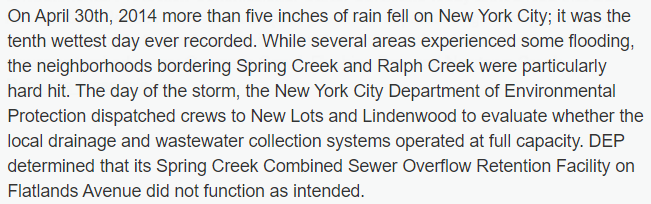

In [34]:
Image('c:/data/capture.png')

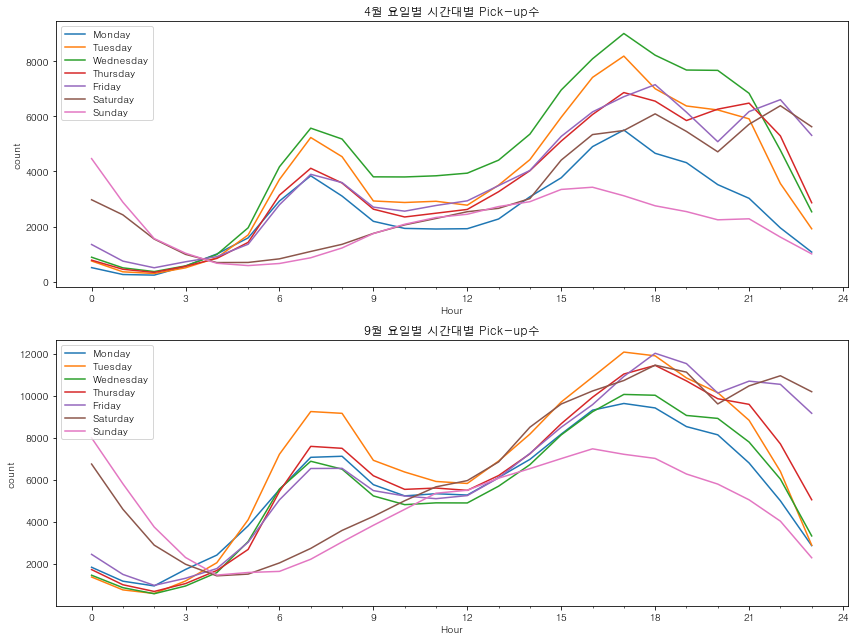

In [25]:
df = uber_df.loc[uber_df['Month']==4,].groupby(['DayofWeek','Hour'])['Month'].count().reset_index(name='count')
df.DayofWeek = pd.Categorical(df.DayofWeek, categories=['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'],
                             ordered=True)

fig, axs = plt.subplots(2,1,figsize=(12,9))
chart = sns.lineplot(data=df, x='Hour',y='count',
             hue='DayofWeek',ax=axs[0]);
chart.xaxis.set_major_locator(MaxNLocator(steps=[3]))
chart.xaxis.set_minor_locator(FixedLocator(range(0,24)))
chart.set_title('4월 요일별 시간대별 Pick-up수')
chart.legend(loc='upper left');

df = uber_df.loc[uber_df['Month']==9,].groupby(['DayofWeek','Hour'])['Month'].count().reset_index(name='count')
df.DayofWeek = pd.Categorical(df.DayofWeek, categories=['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'],
                             ordered=True)
chart = sns.lineplot(data=df, x='Hour',y='count',
             hue='DayofWeek',ax=axs[1]);
chart.xaxis.set_major_locator(MaxNLocator(steps=[3]))
chart.xaxis.set_minor_locator(FixedLocator(range(0,24)))
chart.set_title('9월 요일별 시간대별 Pick-up수')
chart.legend(loc='upper left');
plt.tight_layout()

base별 시간대별 분포도 확인.    
수가 가장 적은 B02512, B02764 제외하고는 시간대별로 같은 양상을 보임.

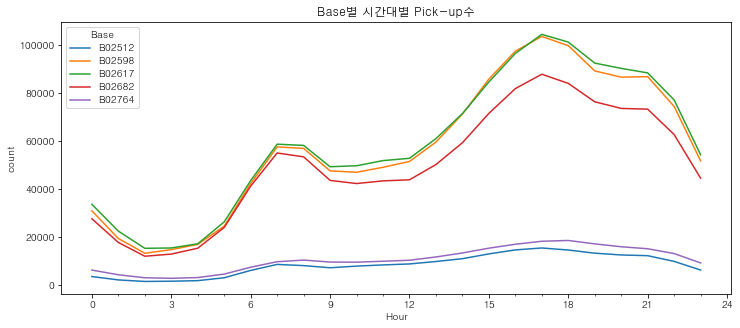

In [41]:
df = uber_df.groupby(['Base','Hour'])['Month'].count().reset_index(name='count')

plt.figure(figsize=(12,5))
chart = sns.lineplot(data=df,x='Hour',y='count',hue='Base')
plt.title('Base별 시간대별 Pick-up수');
chart.xaxis.set_major_locator(MaxNLocator(steps=[3]))
chart.xaxis.set_minor_locator(FixedLocator(range(0,24)))

Base별 월별로 픽업수를 비교해보니, 9월에 픽업수가 가장 많이 늘어나는 걸로 보임.

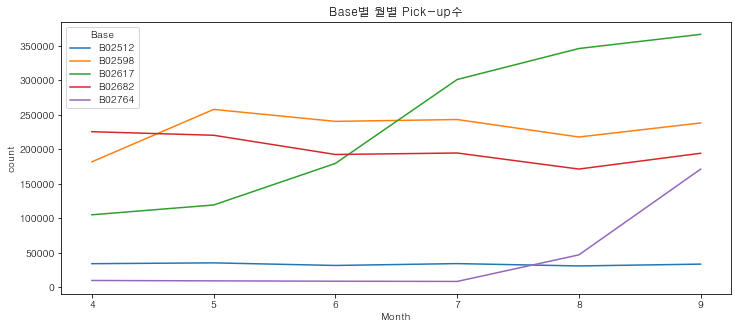

In [42]:
df = uber_df.groupby(['Base','Month'])['Hour'].count().reset_index(name='count')

plt.figure(figsize=(12,5))
chart = sns.lineplot(data=df,x='Month',y='count',hue='Base')
plt.title('Base별 월별 Pick-up수');
chart.xaxis.set_major_locator(MaxNLocator(steps=[3]))
chart.xaxis.set_minor_locator(FixedLocator(range(0,24)))

Base 비율은 B02617이 가장 많고, B02512가 가장 적음.

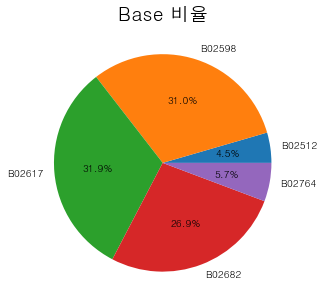

In [71]:
df = uber_df.groupby('Base')['Date/Time'].count().reset_index(name='count')

plt.figure(figsize=(12,5))
plt.pie(df['count'],
       labels=df.Base,
       autopct='%.1f%%');
plt.title('Base 비율',fontsize=19);

In [221]:
base_df = uber_df.groupby(['Base'])['Lat'].count().reset_index(name='count').sort_values('count').reset_index(drop=True)
base_df

,Base,count
0,B02512,200353
1,B02764,254931
2,B02682,1198901
3,B02598,1379578
4,B02617,1417983


Base별로 위도, 경도 분포를 확인함.    
비율이 많을수록 범위가 조금 더 넓게 분포된 걸 확인할 수 있음.

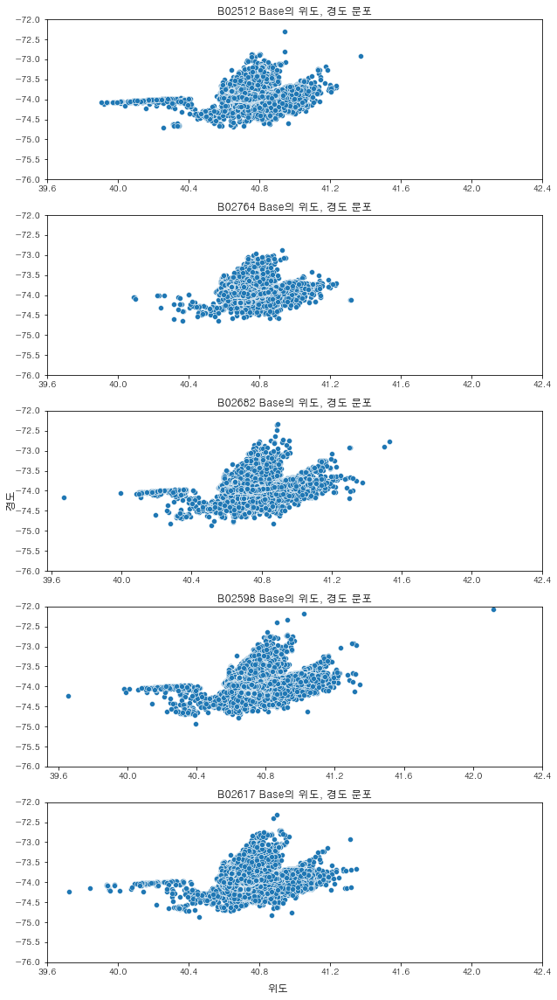

In [220]:
fig,ax = plt.subplots(5,1,figsize=(9,16))
ax = ax.flatten()
a = 0
for i in base_df['Base']:
    chart = sns.scatterplot(data=uber_df.loc[uber_df.Base==i,], x='Lat', y='Lon', ax=ax[a]);
    chart.set_title('{} Base의 위도, 경도 분포'.format(i))
    ax[a].set_ylim(-76,-72)
    ax[a].set_xticks([39.6,40,40.4,40.8,41.2,41.6,42,42.4])
    chart.set_xlabel('')
    chart.set_ylabel('')
    fig.supxlabel('위도')
    fig.supylabel('경도')
    a += 1
fig.tight_layout()

Folium을 통해 Base별 지도에서 탑승 구역 확인함.    
지도상에서도 좀 더 넓은 분포로 픽업이 분포되어 있는 걸 확인할 수 있음.

In [137]:
# 각 Base별로 heatmap folium을 생성하는 함수를 생성함.
def base_heatmap(base):
    m = folium.Map(location=(uber_df.reset_index(drop=True)['Lat'][1],uber_df.reset_index(drop=True)['Lon'][1]),zoom_start=10)
    df = uber_df.loc[uber_df['Base']==base,['Lat','Lon','Day']]
    HeatMap(df.groupby(['Lat','Lon']).count().reset_index()[['Lat','Lon']],radius=15,blur=15).add_to(m)
    return m

In [139]:
base_heatmap('B02512')

In [138]:
base_heatmap('B02617')

전체 데이터를 folium으로 시각화

In [159]:
m = folium.Map(location=(uber_df.reset_index(drop=True)['Lat'][1],uber_df.reset_index(drop=True)['Lon'][1]),zoom_start=10)

In [160]:
HeatMap(uber_df.groupby(['Lat','Lon'])['Day'].count().reset_index()[['Lat','Lon']],zoom=8,radius=15,blur=15).add_to(m)
m